## Importing Libraries

In [1]:
import pandas as pd
from datetime import datetime
import numpy as np
import streamlit as st
import matplotlib.pyplot as plt
import seaborn as sns
import plotly as pl
from sklearn.linear_model import LinearRegression
import statsmodels.api as sm
import altair as alt
import plotly.express as px
from sklearn.preprocessing import MinMaxScaler

%matplotlib inline

In [2]:
prices=pd.read_csv('dataframes/commodity_futures.csv')

In [3]:
rGDP=pd.read_csv('dataframes/quarterly-rGDP.csv')

In [4]:
eCPI=pd.read_csv('dataframes/energy-CPI.csv')

In [5]:
fCPI=pd.read_csv('dataframes/monthly-food-CPI-covid.csv')

### Important dates
1/31/2020 — WHO Issues Global Health Emergency<br>
2/24/2022 - Russian invasion of Ukraine <br>

### Discription of Dataframes
<div>prices - Time series of commodity futures from 2000 until present. Includes 23 different commodities. Prices are in Euros</div>
<div>rGDP - Quarterly U.S. Real Gross Domestic Product (GDP) 2012-2022</div>
<div>eCPI - Energy consumer price index in the U.S. 2008-2021</div>
<div>fCPI - Monthly CPI food at home growth during the COVID-19 outbreak in the U.S. in 2021</div>	

### Plan
prices - clean data, Keep columns that I need like wheat(ukraine is one of the main producers) , Gasoline, Copper(Russia is a big producer), as well as create a ML model __Use line charts__<br>
rGDP - clean data and make graphs with labels illustrating the effect of COVID and of the Ukraine conflict.Replace quarters with dates.<br>
eCPI - clean data, find relationships,graph it out, and reach conclusions<br>
fCPI - clean data, find relationships,graph it out, and reach conclusions<br>	

# Data Cleaning
## Prices Dataframe
#### Issues- 
Invalid data type for date<br>
Inconsistent variable names<br>
Missing values<br>
________________


In [6]:
prices.isna().sum()
#visualizing the missing values, After analysing the dataframe I found that the missing values 
#were almost all in the gasoline column and that the missing values where 
#until 2005-10-03 and after this date we didn't have anymore
#missing values so I decided to drop these missing values

Date                      0
NATURAL GAS               1
GOLD                      1
WTI CRUDE                 1
BRENT CRUDE               1
SOYBEANS                  0
CORN                      0
COPPER                    1
SILVER                    1
LOW SULPHUR GAS OIL       1
LIVE CATTLE               0
SOYBEAN OIL               0
ALUMINIUM                 1
SOYBEAN MEAL              0
ZINC                      0
ULS DIESEL                1
NICKEL                    0
WHEAT                     0
SUGAR                     0
GASOLINE               1483
COFFEE                    0
LEAN HOGS                 0
HRW WHEAT                 0
COTTON                    0
dtype: int64

In [145]:
pd.set_option('display.max_columns', None)
prices.head(15)
#viewing the dataframe

,natural gas,gold,wti crude,brent crude,soybeans,corn,copper,silver,low sulphur gas oil,live cattle,soybean oil,aluminium,soybean meal,zinc,uls diesel,nickel,wheat,sugar,gasoline,coffee,lean hogs,hrw wheat,cotton
date,,,,,,,,,,,,,,,,,,,,,,,
2005-10-03,14.017,466.1,65.47,62.80,581.00,208.75,1.7590,7.455,627.75,89.225,24.46,1847.50,167.3,1404.25,208.09,13505.0,348.75,11.53,188.88,92.85,68.225,381.75,52.55
2005-10-04,14.224,466.1,63.90,61.22,562.50,205.75,1.7660,7.425,607.75,90.950,23.80,1847.25,163.7,1415.50,204.97,13205.0,347.25,11.43,184.53,92.70,68.025,379.00,51.55
2005-10-05,14.183,466.1,62.79,60.12,563.50,204.75,1.7865,7.478,614.50,90.300,23.85,1873.00,162.8,1447.75,201.48,13275.0,345.00,11.44,176.50,93.70,68.200,378.00,52.45
2005-10-06,13.375,471.9,61.36,58.37,564.25,204.25,1.7830,7.595,592.75,89.725,23.82,1880.50,163.7,1446.50,195.07,13215.0,345.25,11.26,172.00,93.50,67.675,381.75,52.75
2005-10-07,13.226,474.7,61.84,59.21,564.25,202.50,1.8085,7.770,595.00,90.250,23.47,1897.00,165.3,1468.00,196.01,13141.0,338.00,11.37,174.00,94.85,68.550,376.75,52.20
2005-10-10,12.975,475.1,61.80,58.78,555.50,202.00,1.8060,7.845,593.75,90.800,23.07,1891.25,164.3,1465.75,197.18,12738.0,339.75,11.66,173.00,98.90,68.325,382.50,55.66
2005-10-11,13.519,477.1,63.53,60.08,563.50,202.50,1.8350,7.875,604.75,90.775,23.40,1928.50,165.1,1483.75,201.79,12766.0,342.75,11.84,177.00,100.75,67.675,382.75,55.17
2005-10-12,13.524,473.9,64.12,60.57,589.00,205.75,1.7935,7.838,604.75,90.775,24.10,1959.00,173.2,1466.25,201.57,12635.0,347.50,11.73,177.57,101.30,67.275,388.25,55.90
2005-10-13,13.103,471.1,63.08,60.14,588.25,203.50,1.7650,7.735,605.75,91.450,23.80,1930.00,175.0,1459.75,199.69,12158.0,343.50,11.69,172.86,100.35,67.350,388.25,56.18


In [8]:
prices.dropna(inplace=True) #dropping missing values 

In [9]:
prices.columns=prices.columns.str.lower() #making all column names lowercased

In [10]:
prices.info()

<class 'pandas.core.frame.DataFrame'>
Int64Index: 4380 entries, 1483 to 5862
Data columns (total 24 columns):
 #   Column               Non-Null Count  Dtype  
---  ------               --------------  -----  
 0   date                 4380 non-null   object 
 1   natural gas          4380 non-null   float64
 2   gold                 4380 non-null   float64
 3   wti crude            4380 non-null   float64
 4   brent crude          4380 non-null   float64
 5   soybeans             4380 non-null   float64
 6   corn                 4380 non-null   float64
 7   copper               4380 non-null   float64
 8   silver               4380 non-null   float64
 9   low sulphur gas oil  4380 non-null   float64
 10  live cattle          4380 non-null   float64
 11  soybean oil          4380 non-null   float64
 12  aluminium            4380 non-null   float64
 13  soybean meal         4380 non-null   float64
 14  zinc                 4380 non-null   float64
 15  uls diesel           4380 non-null 

In [11]:
prices.date=pd.to_datetime(prices.date)
prices.date.describe()
#changing date to date time 

/Users/hamzahjeddin/opt/anaconda3/envs/st-env/lib/python3.7/site-packages/ipykernel_launcher.py:2: FutureWarning: Treating datetime data as categorical rather than numeric in `.describe` is deprecated and will be removed in a future version of pandas. Specify `datetime_is_numeric=True` to silence this warning and adopt the future behavior now.
  


count                    4380
unique                   4380
top       2005-10-03 00:00:00
freq                        1
first     2005-10-03 00:00:00
last      2022-09-16 00:00:00
Name: date, dtype: object

In [12]:
prices.index=pd.DatetimeIndex(data=prices.date)
prices.drop(columns='date',inplace=True)
#setting date as index and dropping column date

In [13]:
prices_norm=(prices-prices.mean())/prices.std()
prices_norm
#standardizing data/ Z-score normalization

,natural gas,gold,wti crude,brent crude,soybeans,corn,copper,silver,low sulphur gas oil,live cattle,soybean oil,aluminium,soybean meal,zinc,uls diesel,nickel,wheat,sugar,gasoline,coffee,lean hogs,hrw wheat,cotton
date,,,,,,,,,,,,,,,,,,,,,,,
2005-10-03,4.179034,-2.173823,-0.279724,-0.558939,-1.834127,-1.663248,-1.959503,-1.761042,-0.214078,-1.195889,-1.226611,-0.595566,-2.128972,-1.556214,-0.173587,-0.577151,-1.487503,-0.980831,-0.341307,-1.183195,-0.429895,-1.278163,-0.958942
2005-10-04,4.268623,-2.173823,-0.348600,-0.622013,-1.900280,-1.683708,-1.949442,-1.765454,-0.304243,-1.111924,-1.277908,-0.596143,-2.174860,-1.539044,-0.218485,-0.616287,-1.496663,-1.000932,-0.409094,-1.186593,-0.441646,-1.293372,-0.997602
2005-10-05,4.250878,-2.173823,-0.397295,-0.665926,-1.896704,-1.690528,-1.919978,-1.757660,-0.273813,-1.143563,-1.274022,-0.536700,-2.186332,-1.489822,-0.268707,-0.607155,-1.510404,-0.998922,-0.534227,-1.163939,-0.431364,-1.298903,-0.962808
2005-10-06,3.901179,-2.158243,-0.460028,-0.735786,-1.894022,-1.693937,-1.925008,-1.740453,-0.371868,-1.171551,-1.276353,-0.519386,-2.174860,-1.491730,-0.360950,-0.614982,-1.508877,-1.035105,-0.604351,-1.168470,-0.462209,-1.278163,-0.951210
2005-10-07,3.836693,-2.150722,-0.438971,-0.702253,-1.894022,-1.705872,-1.888358,-1.714717,-0.361724,-1.145997,-1.303556,-0.481296,-2.154465,-1.458915,-0.347423,-0.624635,-1.553151,-1.012993,-0.573185,-1.137886,-0.410801,-1.305816,-0.972473
...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...
2022-09-12,1.682669,1.223322,0.699006,0.686577,1.629986,1.770530,0.723167,0.047851,1.847333,1.555480,2.462051,0.382651,1.766420,1.200596,2.016918,0.861397,1.520080,0.390083,0.525120,1.872916,0.959612,1.794126,1.270187
2022-09-13,1.697817,1.159661,0.678387,0.653443,1.574561,1.748365,0.659208,-0.005828,1.723355,1.509238,2.465159,0.451905,1.628756,1.261647,1.927985,0.824805,1.529240,0.396114,0.580596,1.786828,1.187280,1.831458,1.119800
2022-09-14,2.057037,1.135754,0.729715,0.690569,1.465497,1.748365,0.608185,0.006085,1.425809,1.487334,2.197020,0.355527,1.618558,1.269278,1.694285,0.815673,1.596414,0.374002,0.649318,1.642971,1.125589,1.928245,1.149568


In [14]:
prices_simple=prices.loc[:,['copper','wheat','gasoline']]
prices_simple
#creating a simplier df with the variables I will use

,copper,wheat,gasoline
date,,,
2005-10-03,1.7590,348.75,188.88
2005-10-04,1.7660,347.25,184.53
2005-10-05,1.7865,345.00,176.50
2005-10-06,1.7830,345.25,172.00
2005-10-07,1.8085,338.00,174.00
...,...,...,...
2022-09-12,3.6255,841.25,244.48
2022-09-13,3.5810,842.75,248.04
2022-09-14,3.5455,853.75,252.45


In [15]:
prices_simple.mean()

copper        3.122348
wheat       592.332763
gasoline    210.782208
dtype: float64

In [16]:
prices_simple_norm=(prices_simple-prices_simple.mean())/prices_simple.std()
prices_simple_norm
#standardizing data/ Z-score normalization to see variables together

,copper,wheat,gasoline
date,,,
2005-10-03,-1.959503,-1.487503,-0.341307
2005-10-04,-1.949442,-1.496663,-0.409094
2005-10-05,-1.919978,-1.510404,-0.534227
2005-10-06,-1.925008,-1.508877,-0.604351
2005-10-07,-1.888358,-1.553151,-0.573185
...,...,...,...
2022-09-12,0.723167,1.520080,0.525120
2022-09-13,0.659208,1.529240,0.580596
2022-09-14,0.608185,1.596414,0.649318


In [17]:
prices_simple.describe()

,copper,wheat,gasoline
count,4380.000000,4380.000000,4380.000000
mean,3.122348,592.332763,210.782208
std,0.695762,163.752750,64.171625
min,1.247500,293.000000,41.180000
25%,2.648000,476.500000,160.182500
50%,3.110500,542.000000,203.585000
75%,3.554125,690.875000,264.157500
max,4.929000,1425.250000,427.620000


## Data exploration and visualization
Prices dataframe<br>
__Making the graphs I need__<br>
__Adding labels to visualize the important dates I am studying__

In [18]:
# plt.figure(figsize=(24,8))
# plt.bar(height=prices_simple.copper,x=prices_simple.index)
# graph.axvline(pd.to_datetime('1/31/2020'),c='r',label='WHO Issues Global Health Emergency')
# graph.axvline(pd.to_datetime('2/24/2022'),c='black',label='Russia Invades Ukraine')
# graph.legend()

In [164]:
chart=px.line(data_frame=prices,labels={'value':"Values",'date':''},title='Price changes of the whole Dataframe(unnormalized)')
chart.add_vrect(x0=pd.to_datetime('1/31/2020'), x1=pd.to_datetime('2/24/2022'),line_width=0, fillcolor="red", opacity=0.2, annotation_text="WHO Issues Global Health Emergency", annotation_position="top left",annotation=dict(font_size=10))
chart.add_vrect(x0=pd.to_datetime('2/24/2022'), x1=pd.to_datetime(prices_simple.index.max()),line_width=0, fillcolor="blue", opacity=0.2, annotation_text="Russia Invades Ukraine", annotation_position="top left",annotation=dict(font_size=10))
chart.update_xaxes(range=[pd.to_datetime('1/1/2014'), pd.to_datetime(prices_simple.index.max())])
chart.update_layout(hovermode="x", legend_title="Commodity Name")


#using ploty for the line Charts!

In [165]:
chart=px.line(data_frame=prices_norm,labels={'value':"Values",'date':''},title='Price changes of the whole Dataframe (normalized)')
chart.add_vrect(x0=pd.to_datetime('1/31/2020'), x1=pd.to_datetime('2/24/2022'),line_width=0, fillcolor="red", opacity=0.2, annotation_text="WHO Issues Global Health Emergency", annotation_position="top left",annotation=dict(font_size=10))
chart.add_vrect(x0=pd.to_datetime('2/24/2022'), x1=pd.to_datetime(prices_simple.index.max()),line_width=0, fillcolor="blue", opacity=0.2, annotation_text="Russia Invades Ukraine", annotation_position="top left",annotation=dict(font_size=10))
chart.update_xaxes(range=[pd.to_datetime('1/1/2014'), pd.to_datetime(prices_simple.index.max())])
chart.update_layout(hovermode="x unified", legend_title="Commodity Name")

#graphing standerized dataframe 

In [166]:
chart=px.line(data_frame=prices_simple,labels={'value':"Values",'date':''},title='Price changes of the simplified Dataframe (unnormalized)')
chart.add_vrect(x0=pd.to_datetime('1/31/2020'), x1=pd.to_datetime('2/24/2022'),line_width=0, fillcolor="red", opacity=0.2, annotation_text="WHO Issues Global Health Emergency", annotation_position="top left",annotation=dict(font_size=10))
chart.add_vrect(x0=pd.to_datetime('2/24/2022'), x1=pd.to_datetime(prices_simple.index.max()),line_width=0, fillcolor="blue", opacity=0.2, annotation_text="Russia Invades Ukraine", annotation_position="top left",annotation=dict(font_size=10))
chart.update_xaxes(range=[pd.to_datetime('1/1/2014'), pd.to_datetime(prices_simple.index.max())])
chart.update_traces(mode="lines", hovertemplate=None)
chart.update_layout(hovermode="x unified", legend_title="Commodity Name")


In [167]:
chart=px.line(data_frame=prices_simple_norm,labels={'value':"Values",'date':''},title='Price changes of the simplified Dataframe (normalized)' )
chart.add_vrect(x0=pd.to_datetime('1/31/2020'), x1=pd.to_datetime('2/24/2022'),line_width=0, fillcolor="red", opacity=0.2, annotation_text="WHO Issues Global Health Emergency", annotation_position="top left",annotation=dict(font_size=10))
chart.add_vrect(x0=pd.to_datetime('2/24/2022'), x1=pd.to_datetime(prices_simple.index.max()),line_width=0, fillcolor="blue", opacity=0.2, annotation_text="Russia Invades Ukraine", annotation_position="top left",annotation=dict(font_size=10))
chart.update_xaxes(range=[pd.to_datetime('1/1/2014'), pd.to_datetime(prices_simple.index.max())])
chart.update_traces(mode="lines", hovertemplate=None)
chart.update_layout(hovermode="x unified", legend_title="Commodity Name")
#graphing standerized dataframe 

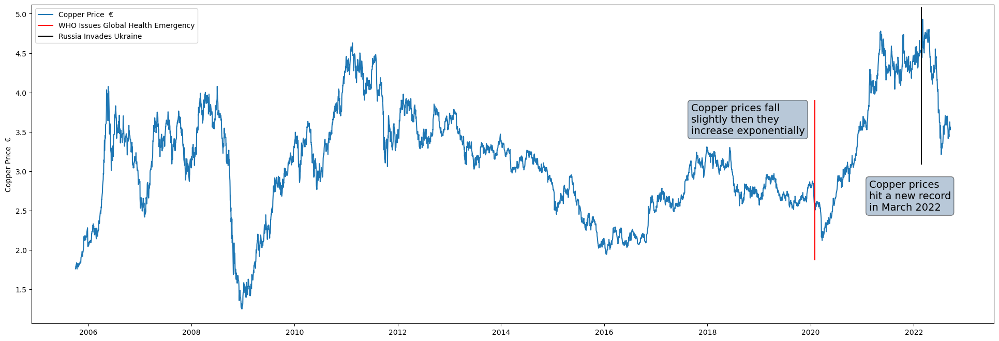

In [168]:
plt.figure(figsize=(24,8))
graph=sns.lineplot(prices_simple.copper,dashes=True,label='Copper Price  €')
graph.axvline(pd.to_datetime('1/31/2020'),c='r',label='WHO Issues Global Health Emergency',ymin=.2,ymax=.7)
graph.axvline(pd.to_datetime('2/24/2022'),c='black',label='Russia Invades Ukraine',ymin=.5,ymax=.99)
plt.xlabel("")
plt.ylabel("Copper Price  €")
props = dict(boxstyle='round', facecolor='#7393B3', alpha=0.5)
string1="Copper prices fall\nslightly then they\nincrease exponentially"
string2="Copper prices\nhit a new record\nin March 2022"
text1=graph.text(0.685,0.64,string1,fontsize=14,transform=graph.transAxes,verticalalignment='center', bbox=props)
text2=graph.text(0.87,0.4,string2,fontsize=14,transform=graph.transAxes,verticalalignment='center', bbox=props)
graph.legend()

In [174]:
chart=px.line(data_frame=prices_simple.copper ,labels={'value':"Copper Price  €",'date':''},title='' )
chart.add_vrect(x0=pd.to_datetime('1/31/2020'), x1=pd.to_datetime('2/24/2022'),line_width=0, fillcolor="red", opacity=0.2, 
                annotation_text="WHO Issues Global<br>Health Emergency",annotation_position="top left",annotation=dict(font_size=12))
chart.add_vrect(x0=pd.to_datetime('2/24/2022'), x1=pd.to_datetime(prices_simple.index.max()),line_width=0, fillcolor="blue", opacity=0.2, 
                annotation_text="Russia Invades<br>Ukraine", annotation_position="bottom right",annotation=dict(font_size=12))
chart.update_xaxes(range=[pd.to_datetime('1/1/2014'), pd.to_datetime(prices_simple.index.max())])
chart.update_traces(mode="lines", hovertemplate=None)
chart.update_layout(hovermode="x unified" , legend_title="Commodity Name",showlegend=False )
# adding chart annotations 
chart.add_annotation(
        x=pd.to_datetime('1/31/2020'),
        y=prices_simple.copper['1/31/2020'],
        xref="x",
        yref="y",
        text='Copper prices fall<br>slightly then they<br>increase exponentially',
        showarrow=True,
        font=dict(
            family="Courier New, monospace",
            size=16,
            color="#ffffff"
            ),
        align="center",arrowhead=2,arrowsize=1,arrowwidth=2,arrowcolor="#636363",ax=-30,ay=-80,bordercolor="#c7c7c7",borderwidth=2,borderpad=4,bgcolor="gray",opacity=0.8
        )
chart.add_annotation(
        x=pd.to_datetime('2/24/2022'),
        y=prices_simple.copper.max(),
        xref="x",
        yref="y",
        text='Copper prices<br>hit a new record<br>in March 2022',
        showarrow=True,
        font=dict(
            family="Courier New, monospace",
            size=16,
            color="#ffffff"
            ),
        align="center",arrowhead=2,arrowsize=1,arrowwidth=2,arrowcolor="#636363",ax=-70,ay=130,bordercolor="#c7c7c7",borderwidth=2,borderpad=4,bgcolor="gray",opacity=0.8)
# Add range slider
chart.update_layout(
    xaxis=dict(
        rangeselector=dict(
            buttons=list([
                dict(step="all",
                    label="View all Data"),
            ])
        ),
        rangeslider=dict(
            visible=True
        ),
        type="date"
    )
)


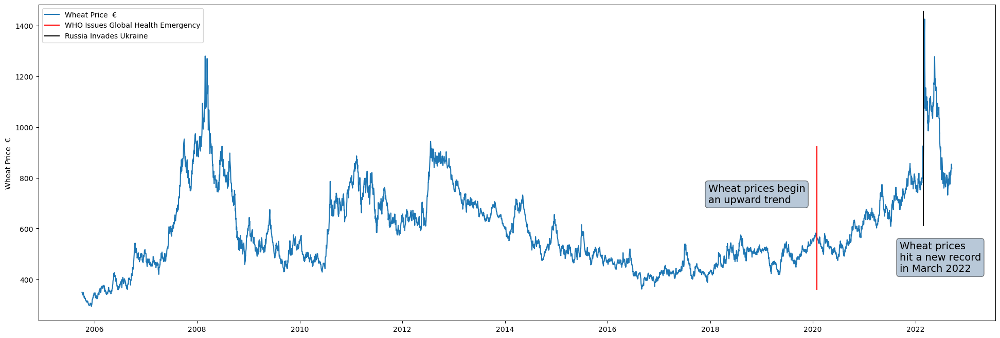

In [170]:
plt.figure(figsize=(24,8))
graph=sns.lineplot(prices_simple.wheat,label='Wheat Price  €')
graph.axvline(pd.to_datetime('1/31/2020'),c='r',label='WHO Issues Global Health Emergency',ymin=.1,ymax=.55)
graph.axvline(pd.to_datetime('2/24/2022'),c='black',label='Russia Invades Ukraine',ymin=.3,ymax=.98,)
plt.xlabel("")
plt.ylabel("Wheat Price  €")
props = dict(boxstyle='round', facecolor='#7393B3', alpha=0.5)
string1="Wheat prices begin\nan upward trend"
string2="Wheat prices\nhit a new record\nin March 2022"
text1=graph.text(0.7,0.4,string1,fontsize=14,transform=graph.transAxes,verticalalignment='center', bbox=props)
text2=graph.text(0.9,0.2,string2,fontsize=14,transform=graph.transAxes,verticalalignment='center', bbox=props)
graph.legend()

In [175]:
chart=px.line(data_frame=prices_simple.wheat ,labels={'value':"Wheat Price  €",'date':''},title='' )
chart.add_vrect(x0=pd.to_datetime('1/31/2020'), x1=pd.to_datetime('2/24/2022'),line_width=0, fillcolor="red", opacity=0.2, 
                annotation_text="WHO Issues Global<br>Health Emergency",annotation_position="top left",annotation=dict(font_size=12))
chart.add_vrect(x0=pd.to_datetime('2/24/2022'), x1=pd.to_datetime(prices_simple.index.max()),line_width=0, fillcolor="blue", opacity=0.2, 
                annotation_text="Russia Invades<br>Ukraine", annotation_position="bottom right",annotation=dict(font_size=12))
chart.update_xaxes(range=[pd.to_datetime('1/1/2014'), pd.to_datetime(prices_simple.index.max())])
chart.update_traces(mode="lines", hovertemplate=None)
chart.update_layout(hovermode="x unified" , legend_title="Commodity Name",showlegend=False)
# adding chart annotations 
chart.add_annotation(
        x=pd.to_datetime('1/31/2020'),
        y=prices_simple.wheat['1/31/2020'],
        xref="x",
        yref="y",
        text='Wheat prices begin<br>an upward trend',
        showarrow=True,
        font=dict(
            family="Courier New, monospace",
            size=16,
            color="#ffffff"
            ),
        align="center",arrowhead=2,arrowsize=1,arrowwidth=2,arrowcolor="#636363",ax=-20,ay=-50,bordercolor="#c7c7c7",borderwidth=2,borderpad=4,bgcolor="gray",opacity=0.8
        )
chart.add_annotation(
        x=pd.to_datetime('2/24/2022'),
        y=prices_simple.wheat.max(),
        xref="x",
        yref="y",
        text="Wheat prices<br>hit a new record<br>in March 2022",
        showarrow=True,
        font=dict(
            family="Courier New, monospace",
            size=16,
            color="#ffffff"
            ),
        align="center",arrowhead=2,arrowsize=1,arrowwidth=2,arrowcolor="#636363",ax=-120,ay=50,bordercolor="#c7c7c7",borderwidth=2,borderpad=4,bgcolor="gray",opacity=0.8)
# Add range slider
chart.update_layout(
    xaxis=dict(
        rangeselector=dict(
            buttons=list([
                dict(step="all",
                    label="View all Data"),
            ])
        ),
        rangeslider=dict(
            visible=True
        ),
        type="date"
    )
)


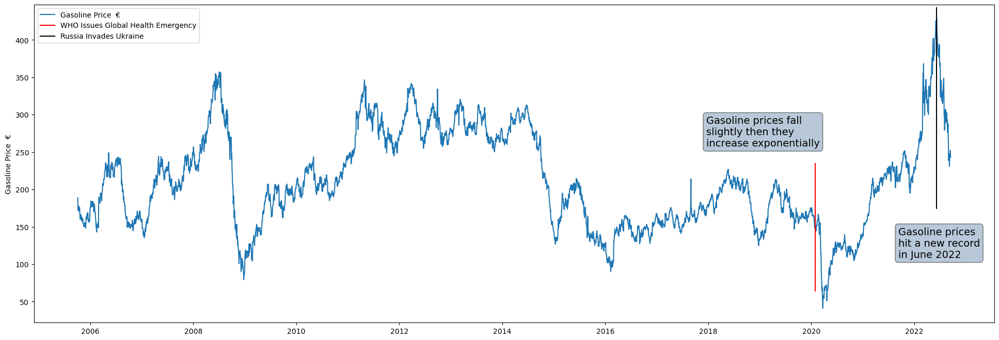

In [27]:
plt.figure(figsize=(24,8))
graph=sns.lineplot(prices_simple.gasoline,dashes=True,label='Gasoline Price  €')
graph.axvline(pd.to_datetime('1/31/2020'),c='r',label='WHO Issues Global Health Emergency',ymin=.1,ymax=.5)
graph.axvline(pd.to_datetime('6/9/2022'),c='black',label='Russia Invades Ukraine',ymin=.36,ymax=.99)
plt.xlabel("")
plt.ylabel("Gasoline Price  €")
props = dict(boxstyle='round', facecolor='#7393B3', alpha=0.5)
string1="Gasoline prices fall\nslightly then they\nincrease exponentially"
string2="Gasoline prices\nhit a new record\nin June 2022"
text1=graph.text(0.7,0.6,string1,fontsize=14,transform=graph.transAxes,verticalalignment='center', bbox=props)
text2=graph.text(0.9,0.25,string2,fontsize=14,transform=graph.transAxes,verticalalignment='center', bbox=props)
plt.legend()

In [28]:
prices_simple.gasoline.max()

427.62

In [176]:
chart=px.line(data_frame=prices_simple.gasoline ,labels={'value':"Gasoline Price  €",'date':''},title='' )
chart.add_vrect(x0=pd.to_datetime('1/31/2020'), x1=pd.to_datetime('2/24/2022'),line_width=0, fillcolor="red", opacity=0.2, 
                annotation_text="WHO Issues Global<br>Health Emergency",annotation_position="top left",annotation=dict(font_size=12))
chart.add_vrect(x0=pd.to_datetime('2/24/2022'), x1=pd.to_datetime(prices_simple.index.max()),line_width=0, fillcolor="blue", opacity=0.2, 
                annotation_text="Russia Invades<br>Ukraine", annotation_position="bottom right",annotation=dict(font_size=12))
chart.update_xaxes(range=[pd.to_datetime('1/1/2014'), pd.to_datetime(prices_simple.index.max())])
chart.update_traces(mode="lines", hovertemplate=None)
chart.update_layout(hovermode="x unified" , legend_title="Commodity Name",showlegend=False )
# adding chart annotations 
chart.add_annotation(
        x=pd.to_datetime('1/31/2020'),
        y=prices_simple.gasoline['1/31/2020'],
        xref="x",
        yref="y",
        text='Gasoline prices fall<br>slightly then they<br>increase exponentially',
        showarrow=True,
        font=dict(
            family="Courier New, monospace",
            size=16,
            color="#ffffff"
            ),
        align="center",arrowhead=2,arrowsize=1,arrowwidth=2,arrowcolor="#636363",ax=-30,ay=-85,bordercolor="#c7c7c7",borderwidth=2,borderpad=4,bgcolor="gray",opacity=0.8
        )
chart.add_annotation(
        x=pd.to_datetime('6/1/2022'),
        y=prices_simple.gasoline.max(),
        xref="x",
        yref="y",
        text="Gasoline prices<br>hit a new record<br>in June 2022",
        showarrow=True,
        font=dict(
            family="Courier New, monospace",
            size=16,
            color="#ffffff"
            ),
        align="center",arrowhead=2,arrowsize=1,arrowwidth=2,arrowcolor="#636363",ax=-150,ay=60,bordercolor="#c7c7c7",borderwidth=2,borderpad=4,bgcolor="gray",opacity=0.8)
# Add range slider
chart.update_layout(
    xaxis=dict(
        rangeselector=dict(
            buttons=list([
                dict(step="all",
                    label="View all Data"),
            ])
        ),
        rangeslider=dict(
            visible=True
        ),
        type="date"
    )
)


## After Taking a look at the prices for Gas,copper, and wheat graphically I say a clear relationship between the three of them. Which is why I will us the data to train a ML model.

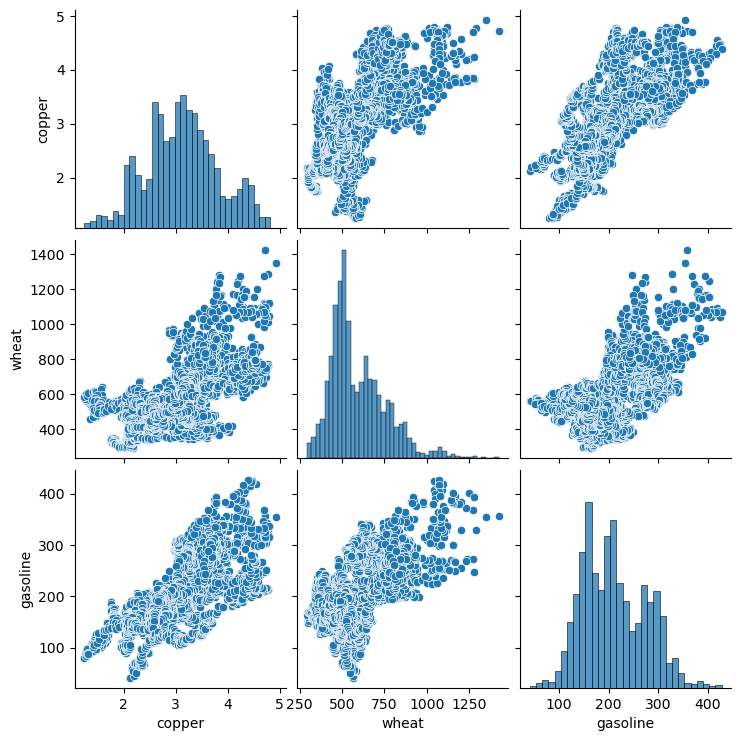

In [30]:
sns.pairplot(prices_simple)
#Firstly, I will start by graphing a pairplot to visuallize the relationship better

In [214]:
fig=px.scatter_matrix(prices_simple)
fig.update_layout(
    title='',
    dragmode='select',
    width=900,
    height=900,
    hovermode='closest',
)


The pairplot shows a clear positive correlation between all three products.

# Machine learning model (supervized)
# Simple Linear Regression

In [31]:
df_corr=prices_simple.corr()
df_corr

,copper,wheat,gasoline
copper,1.000000,0.656782,0.692389
wheat,0.656782,1.000000,0.661367
gasoline,0.692389,0.661367,1.000000


Text(0.5, 1.0, 'Correlation Chart')

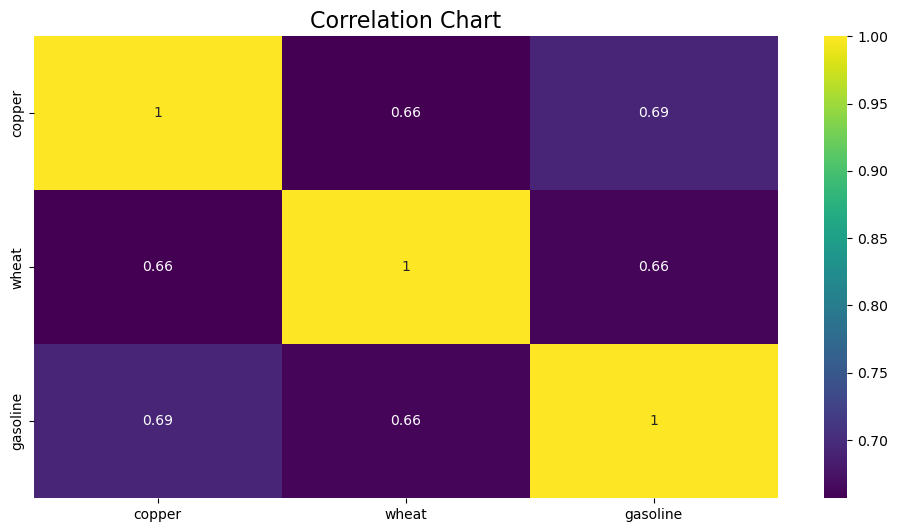

In [32]:
plt.figure(figsize=(12,6))
sns.heatmap(df_corr,cmap='viridis',annot=True)
plt.title('Correlation Chart', fontsize=16)
#making a correlation chart with p values annotated

In [215]:
fig=px.imshow(df_corr, text_auto=True, aspect="auto",color_continuous_scale='RdBu_r', origin='lower')
fig.update_layout(
    title='Correlation Chart',
    dragmode='select',
    width=900,
    height=900,
)


###### We can clearly see that a strong relationship exists between these three variables


Text(0.5, 1.0, 'Wheat Data distribution')

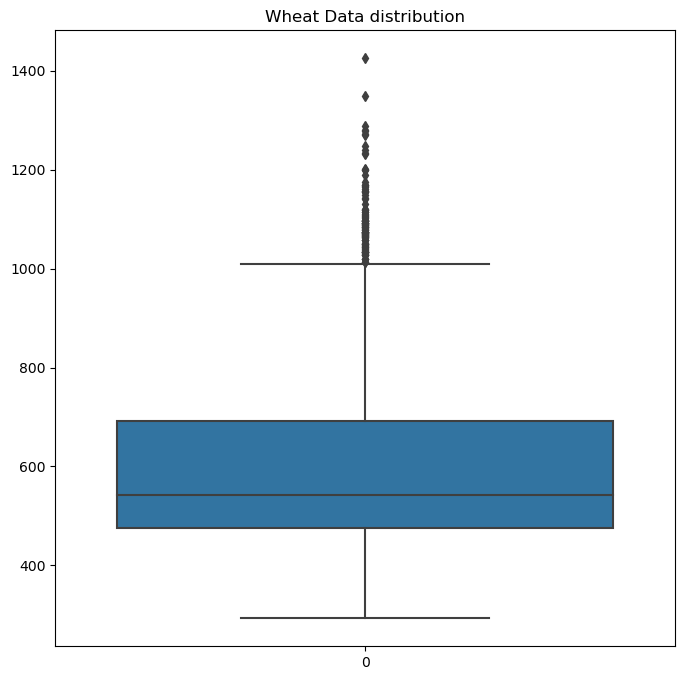

In [33]:
plt.figure(figsize=(8,8))
sns.boxplot(prices_simple.wheat)
plt.title('Wheat Data distribution')
#Just ploting a box chart to see how the data is ditributed (I am not going to drop any values since this is real-life data but just getting an Idea)

Text(0.5, 1.0, 'Copper data distribution')

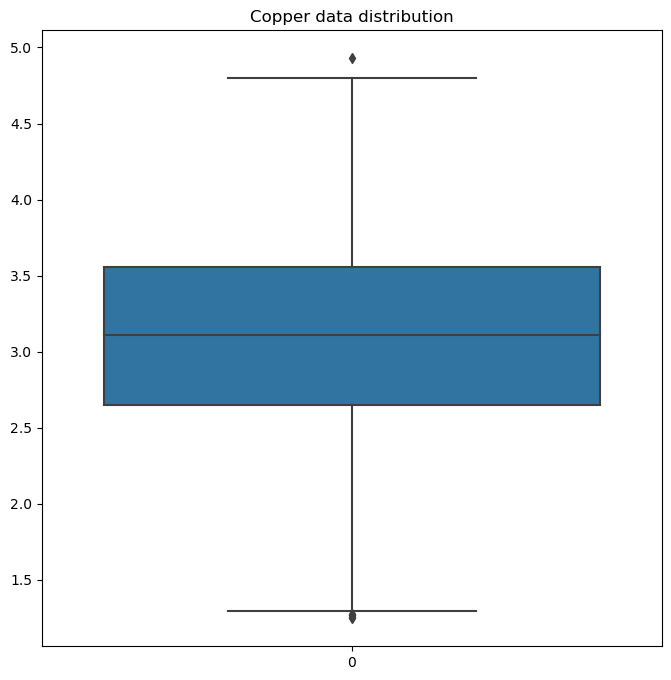

In [34]:
plt.figure(figsize=(8,8))
sns.boxplot(prices_simple.copper)
plt.title('Copper data distribution')
#Just ploting a box chart to see how the data is ditributed (I am not going to drop any values since this is real-life data but just getting an Idea)

In [35]:
# indendent variable
x_dep=prices_simple.wheat
# dependent variable
y=prices_simple.copper
# Building a simple ML model using (Gasoline & copper) 
# predicting the price of copper using the price of wheat

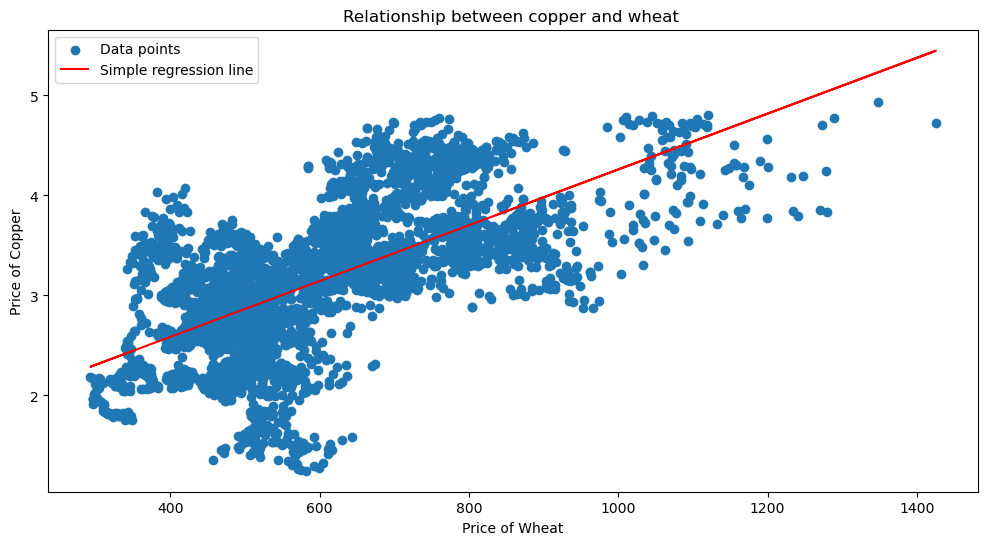

In [36]:

plt.figure(figsize=(12,6))
plt.scatter(x_dep,y,label='Data points' )

m, b = np.polyfit(x_dep, y, 1) #adding a simple linear regression line to scatterplot NO ML yet (Destructured the slope and intercept for x and y) b is intercept. m is the slope

plt.plot(x_dep, m*x_dep+b, c='r', label='Simple regression line') #Graphing the line out using the equation (y=mx+b)

plt.title("Relationship between copper and wheat ")
plt.xlabel("Price of Wheat")
plt.ylabel("Price of Copper")
plt.legend()
#visualizing the relationship between copper and wheat 


## Fitting the regression

In [37]:
x = sm.add_constant(x_dep)
results = sm.OLS(y,x).fit()
# fitting the data to a model and saving the results in the variable "results"
results.summary() #printing statmodel's summary table

<class 'statsmodels.iolib.summary.Summary'>
"""
                            OLS Regression Results                            
==============================================================================
Dep. Variable:                 copper   R-squared:                       0.431
Model:                            OLS   Adj. R-squared:                  0.431
Method:                 Least Squares   F-statistic:                     3321.
Date:                Sat, 01 Oct 2022   Prob (F-statistic):               0.00
Time:                        16:49:31   Log-Likelihood:                -3389.3
No. Observations:                4380   AIC:                             6783.
Df Residuals:                    4378   BIC:                             6795.
Df Model:                           1                                         
Covariance Type:            nonrobust                                         
==============================================================================
                 coef    std err          t      P>|t|      [0.025      0.975]
------------------------------------------------------------------------------
const          1.4694      0.030     49.378      0.000       1.411       1.528
wheat          0.0028   4.84e-05     57.629      0.000       0.003       0.003
==============================================================================
Omnibus:                       40.453   Durbin-Watson:                   0.014
Prob(Omnibus):                  0.000   Jarque-Bera (JB):               49.135
Skew:                          -0.161   Prob(JB):                     2.14e-11
Kurtosis:                       3.407   Cond. No.                     2.31e+03
==============================================================================

Notes:
[1] Standard Errors assume that the covariance matrix of the errors is correctly specified.
[2] The condition number is large, 2.31e+03. This might indicate that there are
strong multicollinearity or other numerical problems.
"""

## explaining the summary table
- __R-squared:__ <br> 0.431(43% could be explained by this model)
- __Coefficient of independent variable__(wheat)<br>
    (0.0028)
-__P-value of T-statistic__<br>
    The p-value is 0 which less than 0.05 which illustrates the significance of the result
- __P-value of F-statistic__<br>
    The f-value is 0 
- __The value of the constant__<br>
    1.4694
    
###### The results clearly show that this is a great Model

In [38]:
equation=(0.0028*x_dep)+1.4694
#saving the results into an equation to graph the linear regression line

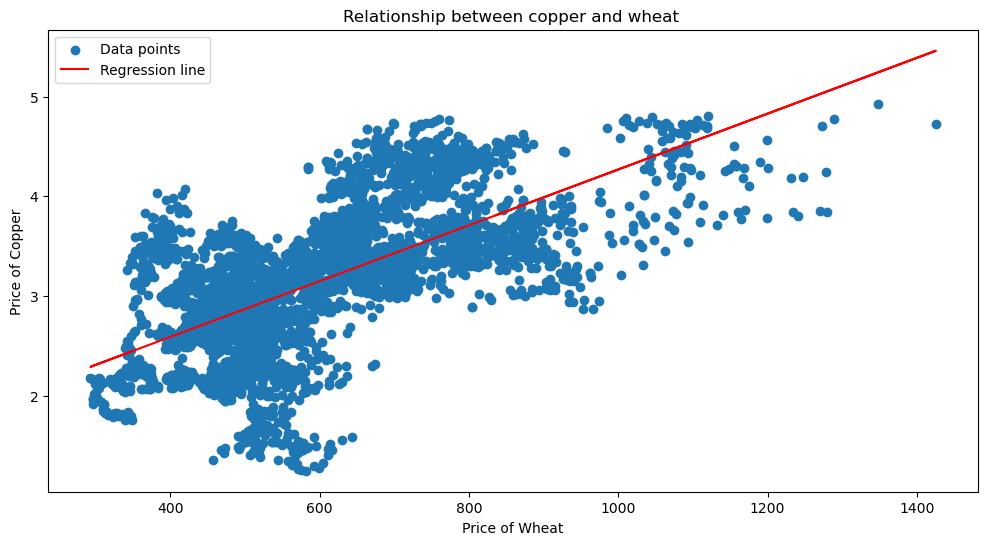

In [161]:
plt.figure(figsize=(12,6))
plt.scatter(x_dep,y,label='Data points')
plt.plot(x_dep,equation, c='r', label='Regression line')
plt.title("Relationship between copper and wheat ")
plt.xlabel("Price of Wheat")
plt.ylabel("Price of Copper")
plt.legend()

In [221]:
fig=px.scatter(y=y,x=x_dep,trendline='ols', trendline_color_override="red",labels={'y':"Price of Copper",'x':"Price of Wheat"},title='Relationship between copper and wheat')
fig.update_layout(
    title='Relationship between copper and wheat',
    dragmode='select',
    width=900,
    height=900,
)

In [40]:
prices_simple

,copper,wheat,gasoline
date,,,
2005-10-03,1.7590,348.75,188.88
2005-10-04,1.7660,347.25,184.53
2005-10-05,1.7865,345.00,176.50
2005-10-06,1.7830,345.25,172.00
2005-10-07,1.8085,338.00,174.00
...,...,...,...
2022-09-12,3.6255,841.25,244.48
2022-09-13,3.5810,842.75,248.04
2022-09-14,3.5455,853.75,252.45


In [41]:
# chart=alt.Chart(prices_simple).mark_point().encode(
#     x='wheat',
#     y='copper'
# )
# chart+chart.transform_regression('copper','wheat').mark_line()

#experimenting with Altair

## Predictions

In [42]:
predict_df=pd.DataFrame({'const':1,"wheat":[400,660,727]})
predict_df
# creating a dataframe and added random prices for wheat to use in predicting the corresponding values for coppper

,const,wheat
0,1,400
1,1,660
2,1,727


In [43]:
prediction=results.predict(predict_df)
prediction
# predictions of copper price

0    2.585629
1    3.311178
2    3.498147
dtype: float64

In [155]:
predict_df['predicted_copper_price']=prediction
predict_df
# joining the prediction with the table

,const,wheat,Predicted Copper Price,predicted_copper_price
0,1,400,2.585629,2.585629
1,1,660,3.311178,3.311178
2,1,727,3.498147,3.498147


# Multiple Linear Regression (using wheat and Gasoline to predict copper price)

In [45]:
# indendent variables
x_deps=prices_simple[['wheat','gasoline']]

# dependent variable
y=prices_simple.copper
# predicting the price of copper using the price of wheat and the price of gasoline

In [46]:
x_deps
#viewing the independent variables


,wheat,gasoline
date,,
2005-10-03,348.75,188.88
2005-10-04,347.25,184.53
2005-10-05,345.00,176.50
2005-10-06,345.25,172.00
2005-10-07,338.00,174.00
...,...,...
2022-09-12,841.25,244.48
2022-09-13,842.75,248.04
2022-09-14,853.75,252.45


In [47]:
x = sm.add_constant(x_deps)
results = sm.OLS(y,x).fit()
# fitting the data to a model and saving the results in the variable "results"
results.summary() #printing statmodel's summary table

<class 'statsmodels.iolib.summary.Summary'>
"""
                            OLS Regression Results                            
==============================================================================
Dep. Variable:                 copper   R-squared:                       0.550
Model:                            OLS   Adj. R-squared:                  0.549
Method:                 Least Squares   F-statistic:                     2672.
Date:                Sat, 01 Oct 2022   Prob (F-statistic):               0.00
Time:                        16:49:31   Log-Likelihood:                -2878.4
No. Observations:                4380   AIC:                             5763.
Df Residuals:                    4377   BIC:                             5782.
Df Model:                           2                                         
Covariance Type:            nonrobust                                         
==============================================================================
                 coef    std err          t      P>|t|      [0.025      0.975]
------------------------------------------------------------------------------
const          1.1847      0.028     42.639      0.000       1.130       1.239
wheat          0.0015   5.75e-05     26.139      0.000       0.001       0.002
gasoline       0.0050      0.000     33.914      0.000       0.005       0.005
==============================================================================
Omnibus:                       84.362   Durbin-Watson:                   0.013
Prob(Omnibus):                  0.000   Jarque-Bera (JB):               88.933
Skew:                           0.349   Prob(JB):                     4.88e-20
Kurtosis:                       3.031   Cond. No.                     2.56e+03
==============================================================================

Notes:
[1] Standard Errors assume that the covariance matrix of the errors is correctly specified.
[2] The condition number is large, 2.56e+03. This might indicate that there are
strong multicollinearity or other numerical problems.
"""

## explaining the summary table
- __R-squared:__ <br> 0.550(55% could be explained by this model)

- __Adj. R-squared:__ <br> 0.549(The same as the R-squared value)

- __Coefficient of independent variables__<br>
    (wheat= 0.0015)/(Gasoline=0.0050 )
-__P-value of T-statistic__<br>
    The p-value is 0 which less than 0.05 which illustrates the significance of the result
- __P-value of F-statistic__<br>
    The f-value is 0 

__Having the same value for the R-squared and the Adj. R-squared shows that using the second variable,gasoline, benefited the model and that we where clearly not penalized for using it__


### predicting values

In [48]:
predict_df_multi=pd.DataFrame({'const':1,"wheat":[400,660,727,800],'gasoline':[50,100,300,400]})
predict_df_multi
# creating a dataframe and added random prices for wheat and gasoline to use in predicting the corresponding values for coppper

,const,wheat,gasoline
0,1,400,50
1,1,660,100
2,1,727,300
3,1,800,400


In [49]:
predictions=results.predict(predict_df_multi)
predictions

0    2.034018
1    2.673116
2    3.768225
3    4.375102
dtype: float64

In [159]:
predict_df_multi['predicted_copper_price']=predictions
predict_df_multi
# joining the predictions with the table

,const,wheat,gasoline,Predicted Copper Price,predicted_copper_price
0,1,400,50,2.034018,2.034018
1,1,660,100,2.673116,2.673116
2,1,727,300,3.768225,3.768225
3,1,800,400,4.375102,4.375102


# Cleaning data 
### __rGDP Dataframe__


view what needs to be changed <br>
variable names need to be changed to lowercase

In [51]:
rGDP.head()

,quarter,GDP
0,Q1 '12,16.13
1,Q2 '12,16.20
2,Q3 '12,16.22
3,Q4 '12,16.24
4,Q1 '13,16.38


In [52]:
rGDP.columns=rGDP.columns.str.lower()
#changing column names to lower case

In [53]:
rGDP.info()
#quater has to be changed to datetime variable

<class 'pandas.core.frame.DataFrame'>
RangeIndex: 42 entries, 0 to 41
Data columns (total 2 columns):
 #   Column   Non-Null Count  Dtype  
---  ------   --------------  -----  
 0   quarter  42 non-null     object 
 1   gdp      42 non-null     float64
dtypes: float64(1), object(1)
memory usage: 800.0+ bytes


In [54]:
rGDP.quarter=rGDP.quarter.str.replace(" '",'20')
rGDP

,quarter,gdp
0,Q12012,16.13
1,Q22012,16.20
2,Q32012,16.22
3,Q42012,16.24
4,Q12013,16.38
5,Q22013,16.40
6,Q32013,16.53
7,Q42013,16.66
8,Q12014,16.62
9,Q22014,16.84


In [55]:
rGDP.quarter=rGDP.quarter.str.replace("Q1",'1/1/')
rGDP.quarter=rGDP.quarter.str.replace("Q2",'4/1/')
rGDP.quarter=rGDP.quarter.str.replace("Q3",'7/1/')
rGDP.quarter=rGDP.quarter.str.replace("Q4",'10/1/')
# replacing quarters with dates to convert variable to Datetime

In [56]:
rGDP.quarter=pd.to_datetime(rGDP.quarter)

In [57]:
rGDP.index=pd.DatetimeIndex(data=rGDP.quarter)

In [58]:
rGDP.drop(columns='quarter',inplace=True)
# dropping 'quarter' column

# Data visualization and exploration
#### rGDP Dataframe 
Make line graph to view the data

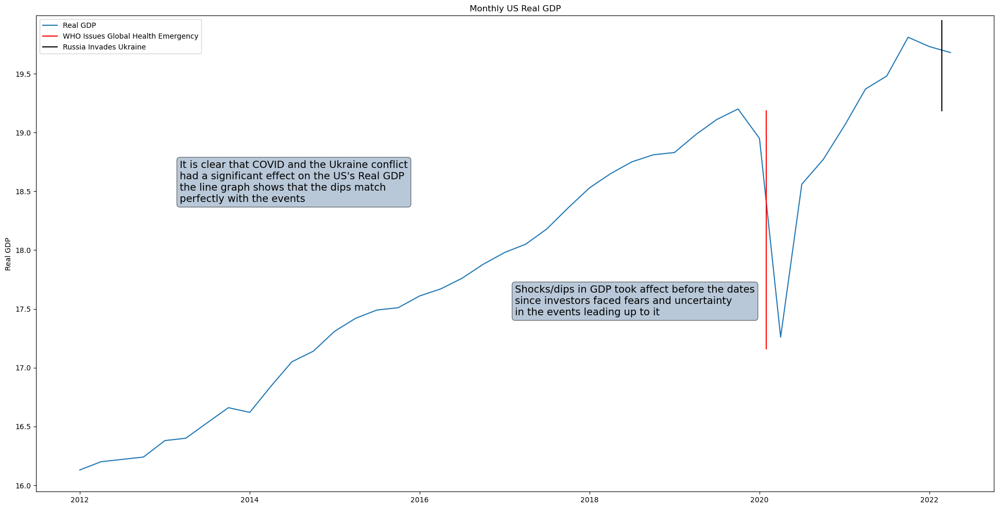

In [59]:
plt.figure(figsize=(24,12))
graph=sns.lineplot(rGDP.gdp,dashes=True, label='Real GDP')
graph.axvline(pd.to_datetime('1/31/2020'),c='r',label='WHO Issues Global Health Emergency',ymin=.3,ymax=.8)
graph.axvline(pd.to_datetime('2/24/2022'),c='black',label='Russia Invades Ukraine',ymin=.8,ymax=.99)
plt.xlabel("")
plt.ylabel("Real GDP")
plt.title('Monthly US Real GDP')
props = dict(boxstyle='round', facecolor='#7393B3', alpha=0.5)
string1="It is clear that COVID and the Ukraine conflict\nhad a significant effect on the US's Real GDP\nthe line graph shows that the dips match\nperfectly with the events"
string2="Shocks/dips in GDP took affect before the dates\nsince investors faced fears and uncertainty\nin the events leading up to it"
text1=graph.text(0.15,0.65,string1,fontsize=14,transform=graph.transAxes,verticalalignment='center', bbox=props)
text2=graph.text(0.5,0.4,string2,fontsize=14,transform=graph.transAxes,verticalalignment='center', bbox=props)
graph.legend()

In [253]:
chart=px.line(data_frame=rGDP.gdp ,labels={'value':"Monthly US Real GDP",'quarter':''},title='' )
chart.add_vrect(x0=pd.to_datetime('1/31/2020'), x1=pd.to_datetime('2/24/2022'),line_width=0, fillcolor="red", opacity=0.2, 
                annotation_text="WHO Issues Global<br>Health Emergency",annotation_position="top left",annotation=dict(font_size=12))
chart.add_vrect(x0=pd.to_datetime('2/24/2022'), x1=pd.to_datetime(rGDP.gdp.index.max()),line_width=0, fillcolor="blue", opacity=0.2)

chart.add_vline(x=pd.to_datetime('1/31/2020'),line_width=2)
chart.add_vline(x=pd.to_datetime('2/24/2022'),line_width=2)

chart.update_xaxes(range=[pd.to_datetime('1/1/2014'), pd.to_datetime(rGDP.gdp.index.max())])
chart.update_traces(mode="lines", hovertemplate=None)
chart.update_layout(hovermode="x unified" , legend_title="Variable",showlegend=False)
# adding chart annotations 
chart.add_annotation(
        x=pd.to_datetime('1/1/2020'),
        y=rGDP.gdp['1/1/2020'],
        xref="x",
        yref="y",
        text="In the events leading up to COVID-19<br>we saw a dip in GDP",
        showarrow=True,
        font=dict(
            family="Courier New, monospace",
            size=14,
            color="#ffffff"
            ),
        align="center",arrowhead=2,arrowsize=1,arrowwidth=2,arrowcolor="#636363",ax=-300,ay=70,bordercolor="#c7c7c7",borderwidth=2,borderpad=4,bgcolor="gray",opacity=0.8
        )
chart.add_annotation(
        x=pd.to_datetime('1/1/2022'),
        y=rGDP.gdp['1/1/2022'],
        xref="x",
        yref="y",
        text="In the events leading up to the <br>Ukraine-Russian Conflict a downward<br>trend took place",
        showarrow=True,
        font=dict(
            family="Courier New, monospace",
            size=14,
            color="#ffffff"
            ),
        align="center",arrowhead=2,arrowsize=1,arrowwidth=2,arrowcolor="#636363",ax=-125,ay=100,bordercolor="#c7c7c7",borderwidth=2,borderpad=4,bgcolor="gray",opacity=0.8
        )
chart.update_layout(
    xaxis=dict(
        rangeselector=dict(
            buttons=list([
                dict(step="all",
                    label="View all Data"),
            ])
        ),
        rangeslider=dict(
            visible=True
        ),
        type="date"
    )
)


# Data cleaning
#### eCPI dataframe
Change year column to datetime __no need since this scaled correctly__ <br>
make variable names lowercase <br>


In [61]:
eCPI.head()

,Year,CPI
0,2008,116.6
1,2009,95.2
2,2010,104.2
3,2011,120.2
4,2012,121.3


In [62]:
eCPI.info()

<class 'pandas.core.frame.DataFrame'>
RangeIndex: 14 entries, 0 to 13
Data columns (total 2 columns):
 #   Column  Non-Null Count  Dtype  
---  ------  --------------  -----  
 0   Year    14 non-null     int64  
 1   CPI     14 non-null     float64
dtypes: float64(1), int64(1)
memory usage: 352.0 bytes


In [63]:
eCPI.columns=eCPI.columns.str.lower()

In [64]:
eCPI.index=eCPI.year
#saving the year as the index

In [65]:
eCPI.drop(columns='year',inplace=True)

## Data exploration and visualization
eCPI dataframe<br>

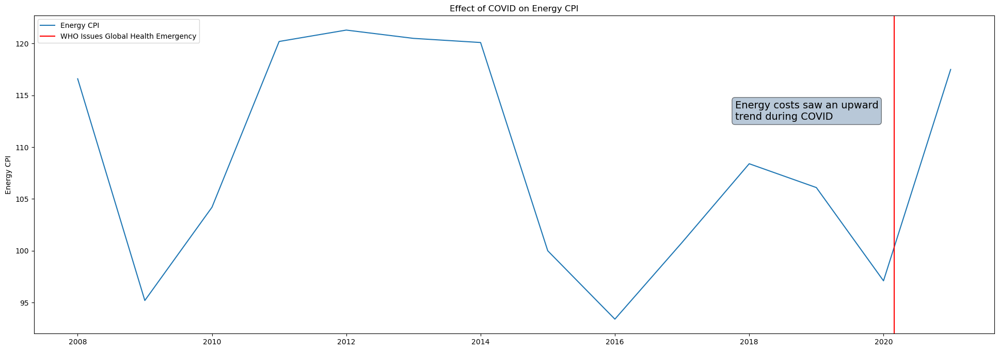

In [66]:
plt.figure(figsize=(24,8))
graph=sns.lineplot(data=eCPI.cpi,dashes=True,label="Energy CPI")
graph.axvline(x=2020.16,c='r',label='WHO Issues Global Health Emergency')
plt.xlabel("")
plt.ylabel("Energy CPI")
plt.title('Effect of COVID on Energy CPI')
props = dict(boxstyle='round', facecolor='#7393B3', alpha=0.5)
string1="Energy costs saw an upward\ntrend during COVID"
text1=graph.text(0.73,0.7,string1,fontsize=14,transform=graph.transAxes,verticalalignment='center', bbox=props)
graph.legend()

In [180]:
chart=px.line(data_frame=eCPI,labels={'value':"Energy CPI",'year':''},title='' )
chart.add_vrect(x0=2020.16, x1=eCPI.index.max(),line_width=0, fillcolor="red", opacity=0.2, 
                annotation_text="WHO Issues Global<br>Health Emergency",annotation_position="top right",annotation=dict(font_size=12))
chart.update_xaxes(range=[2012, eCPI.index.max()])
chart.update_traces(mode="lines", hovertemplate=None)
chart.update_layout(hovermode="x unified" , legend_title="Variable",showlegend=False)
# adding chart annotations 
chart.add_annotation(
        x=2020.16,
        y=101,
        xref="x",
        yref="y",
        text="Energy costs saw an upward<br>trend during COVID",
        showarrow=True,
        font=dict(
            family="Courier New, monospace",
            size=16,
            color="#ffffff"
            ),
        align="center",arrowhead=1,arrowsize=1,arrowwidth=2,arrowcolor="#636363",ax=-100,ay=-150,bordercolor="#c7c7c7",borderwidth=2,borderpad=4,bgcolor="gray",opacity=0.8
        )
chart.update_layout(
    xaxis=dict(
        rangeslider=dict(
            visible=True
        ),
        type="-"
    )
)


# Data cleaning
#### fCPI dataframe
Change Month/year column to datetime  <br>
Make variable names lowercase and make them consistent<br>
Drop percent column

In [68]:
fCPI.head()

,Month/year,percent change,percent
0,Oct-19,0.2,in %
1,Nov-19,0.1,in %
2,Dec-19,0.0,in %
3,Jan-20,0.1,in %
4,Feb-20,0.5,in %


In [69]:
fCPI.info()

<class 'pandas.core.frame.DataFrame'>
RangeIndex: 19 entries, 0 to 18
Data columns (total 3 columns):
 #   Column          Non-Null Count  Dtype  
---  ------          --------------  -----  
 0   Month/year      19 non-null     object 
 1   percent change  19 non-null     float64
 2   percent         19 non-null     object 
dtypes: float64(1), object(2)
memory usage: 584.0+ bytes


In [70]:
fCPI.rename(columns={'Month/year':'date'},inplace=True)
fCPI.rename(columns={'percent change':'percent_change'},inplace=True)

In [71]:
fCPI.drop(columns='percent', inplace=True)

In [72]:
fCPI.index=fCPI.date

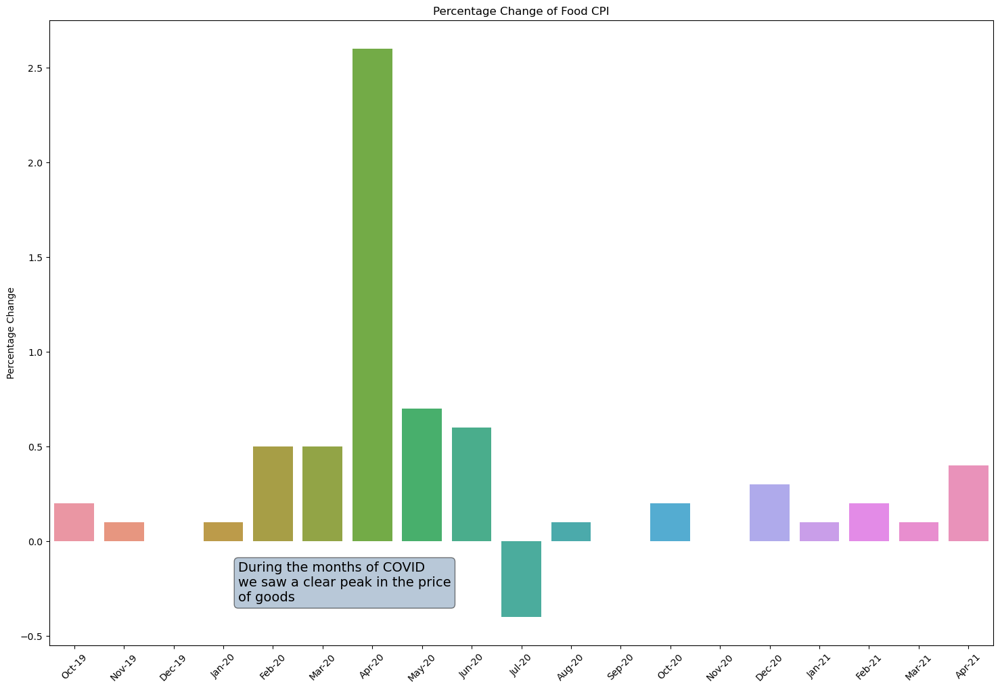

In [73]:
plt.figure(figsize=(18,12)) 
graph=sns.barplot(x=fCPI.index,y=fCPI.percent_change,)
graph.set_xticklabels(graph.get_xticklabels(),rotation=45)
plt.title('Percentage Change of Food CPI')
plt.xlabel("")
plt.ylabel("Percentage Change")
props = dict(boxstyle='round', facecolor='#7393B3', alpha=0.5)
string1="During the months of COVID\nwe saw a clear peak in the price\nof goods"
text1=graph.text(0.2,0.1,string1,fontsize=14,transform=graph.transAxes,verticalalignment='center', bbox=props)


In [179]:
chart=px.bar(fCPI.percent_change,text_auto=True,labels={'value':"Percentage Change",'date':'Percentage Change of Food CPI'},title='' )
chart.update_layout(legend_title="Variable",showlegend=False)
chart.add_annotation(
        x='Apr-20',
        y=-0.2 ,
        xref="x",
        yref="y",
        text="We saw a clear peak in the price of<br>food during the COVID months",
        showarrow=False,
        font=dict(
            family="Courier New, monospace",
            size=14,
            color="#ffffff"
            ),
        align="center",arrowhead=1,arrowsize=1,arrowwidth=2,arrowcolor="#636363",ax=-100,ay=-150,bordercolor="#c7c7c7",borderwidth=2,borderpad=4,bgcolor="purple",opacity=0.8
        )

chart.update_traces(textposition='outside')


In [74]:
# prices.to_csv('prices.csv')
# prices_norm.to_csv('prices_norm.csv')

# prices_simple.to_csv('prices_simple.csv')
# prices_simple_norm.to_csv('prices_simple_norm.csv')
